In [ ]:
# --- Setup: load API keys from environment (safe) ---
import os

# Optional: load from .env if present (pip install python-dotenv once)
try:
    from dotenv import load_dotenv
    load_dotenv()  # will read a local ".env" file if it exists
except Exception:
    pass

PPLX_API_KEY = os.environ.get("PPLX_API_KEY")


def require(name, value):
    if not value or value.strip() == "":
        raise RuntimeError(
            f"{name} is not set. Put it in your OS env or a local .env file (not committed)."
        )
    return value

PPLX_API_KEY = require("PPLX_API_KEY", PPLX_API_KEY)

print("Keys loaded safely from environment.")


In [1]:
!pip install imbalanced-learn==0.11.0

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 235.6/235.6 kB 5.2 MB/s eta 0:00:00:00:01
  Attempting uninstall: imbalanced-learn
    Found existing installation: imbalanced-learn 0.13.0
    Uninstalling imbalanced-learn-0.13.0:
      Successfully uninstalled imbalanced-learn-0.13.0


In [2]:
import pandas as pd
import numpy as np 
import seaborn as sns 
import plotly.express as px
import matplotlib.pyplot as plt 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score
from xgboost import XGBClassifier
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn import svm
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from mlxtend.classifier import StackingClassifier

In [3]:
df=pd.read_csv('/kaggle/input/bank-transaction-fraud-detection/Bank_Transaction_Fraud_Detection.csv')

In [4]:
df.head()

,Customer_ID,Customer_Name,Gender,Age,State,City,Bank_Branch,Account_Type,Transaction_ID,Transaction_Date,...,Merchant_Category,Account_Balance,Transaction_Device,Transaction_Location,Device_Type,Is_Fraud,Transaction_Currency,Customer_Contact,Transaction_Description,Customer_Email
0,d5f6ec07-d69e-4f47-b9b4-7c58ff17c19e,Osha Tella,Male,60,Kerala,Thiruvananthapuram,Thiruvananthapuram Branch,Savings,4fa3208f-9e23-42dc-b330-844829d0c12c,23-01-2025,...,Restaurant,74557.27,Voice Assistant,"Thiruvananthapuram, Kerala",POS,0,INR,+9198579XXXXXX,Bitcoin transaction,oshaXXXXX@XXXXX.com
1,7c14ad51-781a-4db9-b7bd-67439c175262,Hredhaan Khosla,Female,51,Maharashtra,Nashik,Nashik Branch,Business,c9de0c06-2c4c-40a9-97ed-3c7b8f97c79c,11-01-2025,...,Restaurant,74622.66,POS Mobile Device,"Nashik, Maharashtra",Desktop,0,INR,+9191074XXXXXX,Grocery delivery,hredhaanXXXX@XXXXXX.com
2,3a73a0e5-d4da-45aa-85f3-528413900a35,Ekani Nazareth,Male,20,Bihar,Bhagalpur,Bhagalpur Branch,Savings,e41c55f9-c016-4ff3-872b-cae72467c75c,25-01-2025,...,Groceries,66817.99,ATM,"Bhagalpur, Bihar",Desktop,0,INR,+9197745XXXXXX,Mutual fund investment,ekaniXXX@XXXXXX.com
3,7902f4ef-9050-4a79-857d-9c2ea3181940,Yamini Ramachandran,Female,57,Tamil Nadu,Chennai,Chennai Branch,Business,7f7ee11b-ff2c-45a3-802a-49bc47c02ecb,19-01-2025,...,Entertainment,58177.08,POS Mobile App,"Chennai, Tamil Nadu",Mobile,0,INR,+9195889XXXXXX,Food delivery,yaminiXXXXX@XXXXXXX.com
4,3a4bba70-d9a9-4c5f-8b92-1735fd8c19e9,Kritika Rege,Female,43,Punjab,Amritsar,Amritsar Branch,Savings,f8e6ac6f-81a1-4985-bf12-f60967d852ef,30-01-2025,...,Entertainment,16108.56,Virtual Card,"Amritsar, Punjab",Mobile,0,INR,+9195316XXXXXX,Debt repayment,kritikaXXXX@XXXXXX.com


In [5]:
df.nunique()

Customer_ID                200000
Customer_Name              142699
Gender                          2
Age                            53
State                          34
City                          145
Bank_Branch                   145
Account_Type                    3
Transaction_ID             200000
Transaction_Date               31
Transaction_Time            77856
Transaction_Amount         197978
Merchant_ID                200000
Transaction_Type                5
Merchant_Category               6
Account_Balance            197954
Transaction_Device             20
Transaction_Location          148
Device_Type                     4
Is_Fraud                        2
Transaction_Currency            1
Customer_Contact             9000
Transaction_Description       172
Customer_Email               4779
dtype: int64

In [6]:
df.drop(['Customer_ID','Merchant_ID','Transaction_ID','Transaction_Currency'],axis=1,inplace=True)# unwanted columns

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 20 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   Customer_Name            200000 non-null  object 
 1   Gender                   200000 non-null  object 
 2   Age                      200000 non-null  int64  
 3   State                    200000 non-null  object 
 4   City                     200000 non-null  object 
 5   Bank_Branch              200000 non-null  object 
 6   Account_Type             200000 non-null  object 
 7   Transaction_Date         200000 non-null  object 
 8   Transaction_Time         200000 non-null  object 
 9   Transaction_Amount       200000 non-null  float64
 10  Transaction_Type         200000 non-null  object 
 11  Merchant_Category        200000 non-null  object 
 12  Account_Balance          200000 non-null  float64
 13  Transaction_Device       200000 non-null  object 
 14  Tran

In [8]:
df.isna().sum()

Customer_Name              0
Gender                     0
Age                        0
State                      0
City                       0
Bank_Branch                0
Account_Type               0
Transaction_Date           0
Transaction_Time           0
Transaction_Amount         0
Transaction_Type           0
Merchant_Category          0
Account_Balance            0
Transaction_Device         0
Transaction_Location       0
Device_Type                0
Is_Fraud                   0
Customer_Contact           0
Transaction_Description    0
Customer_Email             0
dtype: int64

In [9]:
df.describe()

,Age,Transaction_Amount,Account_Balance,Is_Fraud
count,200000.000000,200000.000000,200000.000000,200000.000000
mean,44.015110,49538.015554,52437.988784,0.050440
std,15.288774,28551.874004,27399.507128,0.218852
min,18.000000,10.290000,5000.820000,0.000000
25%,31.000000,24851.345000,28742.395000,0.000000
50%,44.000000,49502.440000,52372.555000,0.000000
75%,57.000000,74314.625000,76147.670000,0.000000
max,70.000000,98999.980000,99999.950000,1.000000


# EDA

In [11]:
import plotly.express as px

fig = px.histogram(df, 
                   x='Transaction_Amount', 
                   nbins=50,
                   color_discrete_sequence=['#636EFA'],  # Blue shade
                   title='Transaction Amount Distribution')
fig.update_layout(xaxis_title='Transaction Amount', yaxis_title='Count')
fig.show()


In [12]:
fig = px.bar(df.groupby('Transaction_Type')['Is_Fraud'].sum().reset_index(),
             x='Transaction_Type', y='Is_Fraud',
             color='Transaction_Type',  
             title='Total Fraud Cases by Transaction Type',
             color_discrete_sequence=px.colors.qualitative.Plotly)
fig.update_layout(xaxis_title='Transaction Type', yaxis_title='Fraud Cases')
fig.show()


In [13]:
fig = px.bar(df.groupby('State')['Account_Balance'].mean().reset_index(),
             x='State', y='Account_Balance',
             color='State',  
             title='Average Account Balance by State',
             color_discrete_sequence=px.colors.qualitative.Vivid)
fig.update_layout(xaxis_title='State', yaxis_title='Average Balance')
fig.show()


In [14]:
fig = px.bar(df.groupby('Gender')['Is_Fraud'].sum().reset_index(),
             x='Gender', y='Is_Fraud',
             color='Gender',
             title='Fraud Cases by Gender',
             color_discrete_sequence=['#FF6692', '#19D3F3'])  
fig.update_layout(xaxis_title='Gender', yaxis_title='Fraud Cases')
fig.show()


In [15]:
df['Transaction_Date'] = pd.to_datetime(df['Transaction_Date'])

fig = px.histogram(df, 
                   x='Transaction_Date',
                   color_discrete_sequence=['#00CC96'], 
                   title='Transaction Count Over Time')
fig.update_layout(xaxis_title='Transaction Date', yaxis_title='Transaction Count')
fig.show()


/tmp/ipykernel_36/1021711799.py:1: UserWarning:

Parsing dates in %d-%m-%Y format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.



In [16]:
fig = px.pie(df, names='Device_Type', title='Device Type Usage',
             color_discrete_sequence=px.colors.sequential.Rainbow)
fig.show()


In [17]:
fig = px.box(df, x='Transaction_Type', y='Transaction_Amount', 
             color='Transaction_Type',
             title='Transaction Amount by Type (Box Plot)',
             color_discrete_sequence=px.colors.qualitative.Safe)
fig.update_layout(xaxis_title='Transaction Type', yaxis_title='Transaction Amount')
fig.show()


In [18]:
tempdf=df['Is_Fraud'].value_counts().reset_index()
fig=px.bar(tempdf,x='Is_Fraud',y='count',color='count',title='Value count for target Column')
fig.show()

In [19]:
import plotly.express as px

numeric_booking = df.select_dtypes(include='number')
fig = px.box(numeric_booking, orientation='h', title="Box Plot for Every Variable")
fig.show()

# PREPROCESSING

## LABEL ENCODING

In [10]:
X = df.drop("Is_Fraud", axis=1)
y = df["Is_Fraud"]

In [11]:
col = X.select_dtypes(exclude=['float64','int64']).columns.tolist()
#label encoding(converting categorical data to number)
le = LabelEncoder()
X[col] = X[col].apply(le.fit_transform).astype('int')

In [12]:
X.head()

,Customer_Name,Gender,Age,State,City,Bank_Branch,Account_Type,Transaction_Date,Transaction_Time,Transaction_Amount,Transaction_Type,Merchant_Category,Account_Balance,Transaction_Device,Transaction_Location,Device_Type,Customer_Contact,Transaction_Description,Customer_Email
0,93485,1,60,15,127,127,2,22,52151,32415.45,3,5,74557.27,17,129,3,7579,9,3129
1,54871,0,51,18,100,100,0,10,55958,43622.60,0,5,74622.66,9,102,1,74,65,1840
2,36850,1,20,4,13,13,2,24,10257,63062.56,0,3,66817.99,0,13,1,6745,102,1234
3,135649,0,57,28,22,22,0,18,40370,14000.72,2,2,58177.08,8,24,2,4889,51,4544
4,71549,0,43,25,7,7,2,29,60052,18335.16,3,2,16108.56,16,7,2,4316,37,2389


In [13]:
numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns

# Correlation matrix
correlation = df[numeric_cols].corr().round(2)

# Plot improved heatmap
fig = px.imshow(correlation, 
                text_auto=True, 
                aspect="auto",
                color_continuous_scale='Viridis',  # More readable colors
                title="Correlation Matrix (Numeric Features Only)")
fig.update_layout(margin=dict(l=80, r=80, t=80, b=80))
fig.show()

## SAMPLING

In [14]:
from imblearn.over_sampling import SMOTE
smote =SMOTE(sampling_strategy='minority') # oversampling to balance the data
sm_x,sm_y=smote.fit_resample(X,y)

In [15]:
tempdf=sm_y.value_counts().reset_index()
fig=px.bar(tempdf,x='Is_Fraud',y='count',color='Is_Fraud',title='Value count after over sampling')
fig.show()

## SCALING

In [16]:
col = sm_x.columns
minmaxtranform = MinMaxScaler() # Scaler to bring all the values to a common unit
sm_x= minmaxtranform.fit_transform(sm_x)

In [17]:
sm_x = pd.DataFrame(sm_x,columns=col)

In [18]:
print(sm_x.shape)
print(sm_y.shape)

(379824, 19)
(379824,)


# TRAIN TEST SPLIT

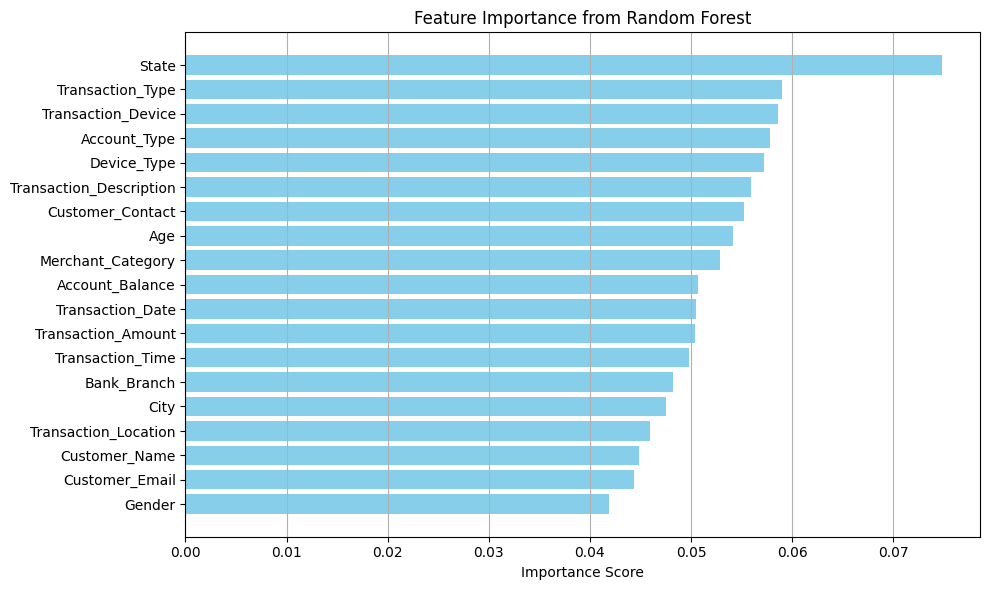

In [19]:
rf = RandomForestClassifier()
rf.fit(sm_x,sm_y)
importances = rf.feature_importances_
feature_names = X.columns  # Or use list of column names if it's a NumPy array

# Create DataFrame for easy sorting and plotting
feat_imp_df = pd.DataFrame({'Feature': feature_names, 'Importance': importances})
feat_imp_df = feat_imp_df.sort_values(by='Importance', ascending=False)

# Plot
plt.figure(figsize=(10, 6))
plt.barh(feat_imp_df['Feature'], feat_imp_df['Importance'], color='skyblue')
plt.xlabel('Importance Score')
plt.title('Feature Importance from Random Forest')
plt.gca().invert_yaxis()  # Most important at the top
plt.grid(True, axis='x')
plt.tight_layout()
plt.show()

In [20]:
imp=feat_imp_df[:15]
newx=sm_x[imp['Feature']]

In [21]:
#split data in train and test with ratio of 80/20
X_train, X_test, y_train, y_test = train_test_split(newx,sm_y,test_size=0.1, stratify=sm_y, random_state=1)

# MODEL TRAINING

## LOGISTIC REGRESSION

In [32]:
lr = LogisticRegression( C= 0.1, l1_ratio= 0, penalty= 'l2', solver='lbfgs',random_state=1)
lr.fit(X_train, y_train)
y_pred = lr.predict(X_test)

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1165: UserWarning:

l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)



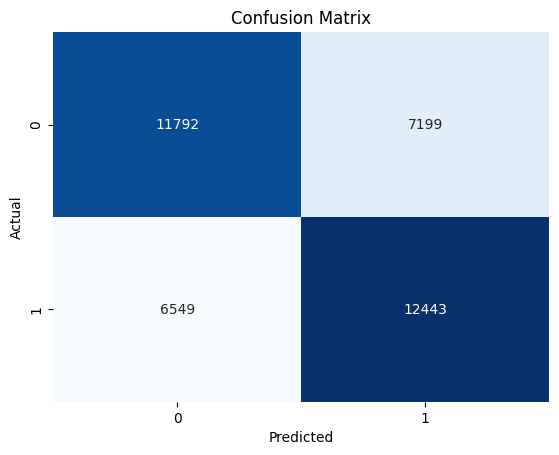

In [33]:
matrix = confusion_matrix(y_test, y_pred)  
sns.heatmap(matrix, annot=True, cbar=False, cmap='Blues', fmt="d")  
plt.xlabel('Predicted')  
plt.ylabel('Actual')  
plt.title('Confusion Matrix')  
plt.show() 

In [34]:
#Classification Report
print("Classification Report : ") 
print(classification_report(y_test, y_pred))  

Classification Report : 
              precision    recall  f1-score   support

           0       0.64      0.62      0.63     18991
           1       0.63      0.66      0.64     18992

    accuracy                           0.64     37983
   macro avg       0.64      0.64      0.64     37983
weighted avg       0.64      0.64      0.64     37983



# RANDOM FOREST

In [35]:
rfmodel = RandomForestClassifier(max_depth=5)
rfmodel.fit(X_train,y_train)
y_pred = rfmodel.predict(X_test)

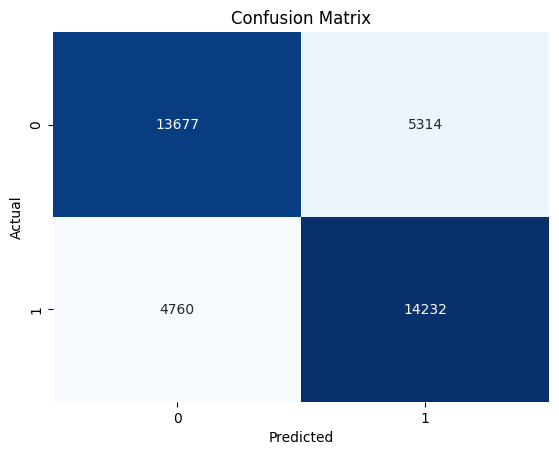

In [36]:

matrix = confusion_matrix(y_test, y_pred)
sns.heatmap(matrix, annot=True, cbar=False, cmap='Blues', fmt="d")
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


In [37]:
#Classification Report
print("Classification Report : ")
print(classification_report(y_test, y_pred))

Classification Report : 
              precision    recall  f1-score   support

           0       0.74      0.72      0.73     18991
           1       0.73      0.75      0.74     18992

    accuracy                           0.73     37983
   macro avg       0.73      0.73      0.73     37983
weighted avg       0.73      0.73      0.73     37983



# DECISION TREE

In [38]:
dt = DecisionTreeClassifier(random_state=1)
dt.fit(X_train,y_train)
y_pred = dt.predict(X_test)

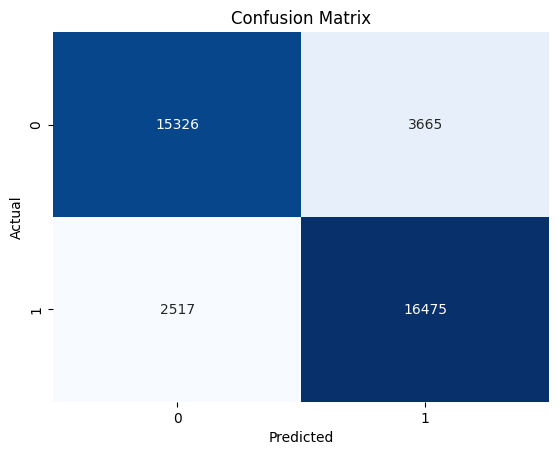

In [39]:
matrix = confusion_matrix(y_test, y_pred)
sns.heatmap(matrix, annot=True, cbar=False, cmap='Blues', fmt="d")
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


In [40]:
#Classification Report
print("Classification Report : ")
print(classification_report(y_test, y_pred))

Classification Report : 
              precision    recall  f1-score   support

           0       0.86      0.81      0.83     18991
           1       0.82      0.87      0.84     18992

    accuracy                           0.84     37983
   macro avg       0.84      0.84      0.84     37983
weighted avg       0.84      0.84      0.84     37983



# ADA BOOST

In [41]:
ada = AdaBoostClassifier(random_state=1)
ada.fit(X_train, y_train)
y_pred = ada.predict(X_test)

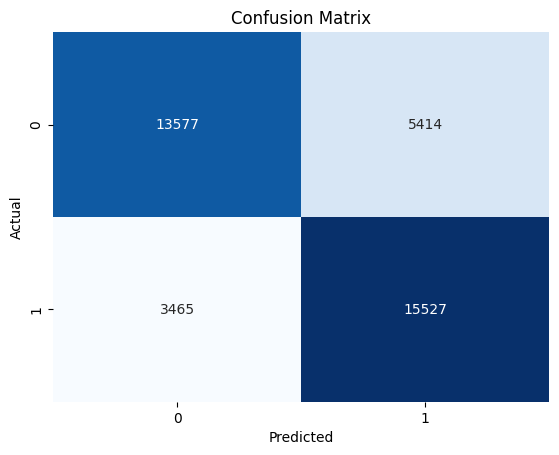

In [42]:
matrix = confusion_matrix(y_test, y_pred)
sns.heatmap(matrix, annot=True, cbar=False, cmap='Blues', fmt="d")
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


In [43]:
#Classification Report
print("Classification Report : ")
print(classification_report(y_test, y_pred))

Classification Report : 
              precision    recall  f1-score   support

           0       0.80      0.71      0.75     18991
           1       0.74      0.82      0.78     18992

    accuracy                           0.77     37983
   macro avg       0.77      0.77      0.77     37983
weighted avg       0.77      0.77      0.77     37983



## XG BOOST

In [44]:
model = XGBClassifier(max_depth=5,random_state=1)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)  

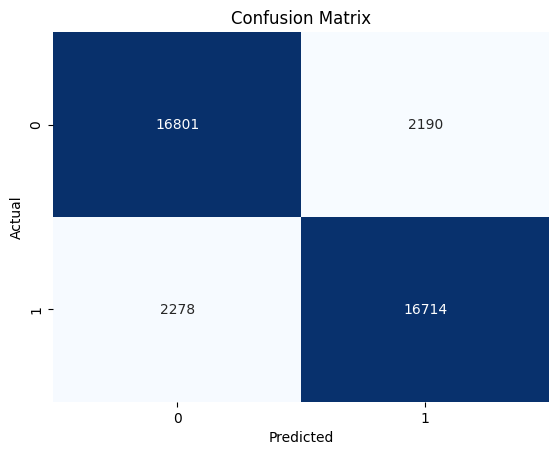

In [45]:
matrix = confusion_matrix(y_test, y_pred)  # Generate the confusion matrix
sns.heatmap(matrix, annot=True, cbar=False, cmap='Blues', fmt="d")  # Create a heatmap of the confusion matrix
plt.xlabel('Predicted')  # Label for X-axis
plt.ylabel('Actual')  # Label for Y-axis
plt.title('Confusion Matrix')  # Title of the plot
plt.show()  # Display the plot

In [46]:
#Classification Report
print("Classification Report : ") 
print(classification_report(y_test, y_pred))  

Classification Report : 
              precision    recall  f1-score   support

           0       0.88      0.88      0.88     18991
           1       0.88      0.88      0.88     18992

    accuracy                           0.88     37983
   macro avg       0.88      0.88      0.88     37983
weighted avg       0.88      0.88      0.88     37983



## STACKING

In [22]:
# Define base models
model1 =  AdaBoostClassifier(random_state=1)
model2 =  RandomForestClassifier(random_state=1)
model3 = LogisticRegression(random_state=1)

# Define meta-model
meta_model = XGBClassifier(random_state=1)

# Create Stacking Classifier
stac_model = StackingClassifier(
    classifiers=[model1, model2, model3],
    meta_classifier=meta_model
)

# Fit the model
stac_model.fit(X_train, y_train)

# Predict
y_pred = stac_model.predict(X_test.values)


/usr/local/lib/python3.11/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but AdaBoostClassifier was fitted with feature names

/usr/local/lib/python3.11/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but RandomForestClassifier was fitted with feature names

/usr/local/lib/python3.11/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



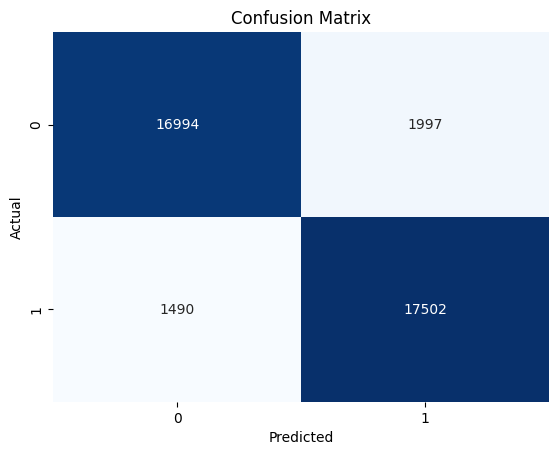

In [23]:
matrix = confusion_matrix(y_test, y_pred)
sns.heatmap(matrix, annot=True, cbar=False, cmap='Blues', fmt="d")
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


In [24]:
#Classification Report
print("Classification Report : ")
print(classification_report(y_test, y_pred))

Classification Report : 
              precision    recall  f1-score   support

           0       0.92      0.89      0.91     18991
           1       0.90      0.92      0.91     18992

    accuracy                           0.91     37983
   macro avg       0.91      0.91      0.91     37983
weighted avg       0.91      0.91      0.91     37983



# EXPLAINABLE AI

In [50]:
from lime import lime_tabular

feature_names = [i for i in X.columns]

# Ensure X_train is a NumPy array
explainer = lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,        
    feature_names=feature_names,
    mode='classification'
)
 
# Pick a sample from test set to explain
sample_idx = 1  

# Ensure X_test is also a NumPy array when passing a single row
explanation = explainer.explain_instance(
    data_row=X_test.iloc[sample_idx].values,
    predict_fn=stac_model.predict_proba    # returns class probabilities
)
# Visualize explanation
explanation.show_in_notebook(show_table=True)


/usr/local/lib/python3.11/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but AdaBoostClassifier was fitted with feature names

/usr/local/lib/python3.11/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but RandomForestClassifier was fitted with feature names

/usr/local/lib/python3.11/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



## GPT

In [26]:
# Create LIME tabular explainer
explainer = lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X.columns.tolist(),
    class_names=[0,1],  # optional: update for your class labels
    mode='classification'
)

# Pick a test instance index to explain
sample_idx = 1   

# Explain that instance
explanation = explainer.explain_instance(
    data_row=X_test.iloc[sample_idx].values,
    predict_fn=stac_model.predict_proba  # If you're using stacking, use stac_model.predict_proba
)

# Convert explanation to DataFrame (tabular format)
exp_list = explanation.as_list()
exp_df = pd.DataFrame(exp_list, columns=['Feature', 'Importance'])

# Show explanation as DataFrame (tabular)
print("LIME Explanation for Instance Index", sample_idx)
print(exp_df)

# OPTIONAL: Save explanation to CSV
exp_df.to_csv("lime_explanation_instance_{}.csv".format(sample_idx), index=False)

# Show in notebook (if used in Jupyter)
explanation.show_in_notebook(show_table=True)


/usr/local/lib/python3.11/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but AdaBoostClassifier was fitted with feature names

/usr/local/lib/python3.11/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but RandomForestClassifier was fitted with feature names



LIME Explanation for Instance Index 1
                           Feature  Importance
0                      City > 0.67   -0.464064
1                     State > 0.50   -0.381524
2  0.27 < Transaction_Date <= 0.50    0.074845
3  0.40 < Transaction_Time <= 0.80    0.073737
4       0.50 < Bank_Branch <= 0.72    0.068568
5      0.28 < Account_Type <= 0.50    0.064817
6  0.27 < Transaction_Type <= 0.47    0.052769
7       Transaction_Device <= 0.26   -0.016827
8     Transaction_Location <= 0.26   -0.015697
9     0.27 < Customer_Name <= 0.48    0.014569


/usr/local/lib/python3.11/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



In [27]:
import requests

headers = {
    "Authorization": f"Bearer {api_key}",
    "Content-Type": "application/json"
}
payload = {
    "model": "sonar-pro",   # or "gpt-4.1", "claude-4-sonnet", etc.
    "messages": [
        {"role": "system", "content": "You are a helpful assistant."},
        {"role": "user", "content": f"This is a credit card fraud detection project,this are the feature of {X_test.iloc[sample_idx]},and thsi is acutal output of the records{y_test.iloc[sample_idx]} and this is the output of explainable ai {exp_df} , just give the summary of the output and tell the reason for the output by using shpae ai prediction,  0='not fraud, 1= Fraud':\n\n"}
    ],
    "temperature": 0.8
}
response = requests.post(url, headers=headers, json=payload)
print(response.json()["choices"][0]["message"]["content"])


The explainable AI (XAI) output for your credit card fraud detection project identifies which features most influenced the model's prediction for a specific transaction record. For this record, the model output is **0 ("not fraud")**.

**Summary of Output and SHAP Explanation:**

- **Key features pushing towards "not fraud":**
    - **City > 0.67**: Strongly decreases the likelihood of fraud (**SHAP value: -0.464064**).
    - **State > 0.50**: Also decreases fraud probability (**-0.381524**).
    - **Transaction_Device <= 0.26** and **Transaction_Location <= 0.26**: Both slightly lower the chance of fraud (small negative SHAP values).

- **Features slightly increasing fraud probability:**
    - **0.27 < Transaction_Date ≤ 0.50**, **0.40 < Transaction_Time ≤ 0.80**, **0.50 < Bank_Branch ≤ 0.72**, and **Account_Type/Transaction_Type ranges**: These have small positive SHAP values, indicating minor contribution toward a fraud prediction.

**Interpretation using SHAP/Explainable AI:**

- *